In [1]:
from sdfray.light import DistantLight,PointLight,AmbientLight
from sdfray.scene import Scene,Camera
from sdfray.geom import Union,Intersection,Subtraction
from sdfray.shapes import Sphere,Box,Cylinder,Plane
from sdfray.surface import UniformSurface,SurfaceProp,CheckerSurface
from sdfray.util import *

import numpy as np

In [2]:
lights = [
    PointLight([10,0,0],[2,2.5,-2]),
    PointLight([0,10,0],[-2,2.5,0]),
    DistantLight([0,0,1.5],[2,2.5,2]),
    l:=AmbientLight([0.05,0.05,0.05])
]

In [3]:
import io
import imageio
import base64 
from IPython.display import HTML

def encode_gif(scene,times=np.linspace(0,2*np.pi,300)):
    output = io.BytesIO()
    with imageio.get_writer(output, format='gif', mode='I', duration='0.05') as writer:
        for time in times:
            v = scene.render(time=time)
            writer.append_data(np.asarray(v))
    output.seek(0)
    return output.read()

def display_gif(gif):
    b64 = base64.b64encode(gif)
    display(HTML(f'<img src="data:image/gif;base64,{b64.decode()}"/>'))
    
def encode_mp4(scene,times=np.linspace(0,2*np.pi,600)):
    output = io.BytesIO()
    with imageio.get_writer(output, format='mp4', mode='I', fps=60) as writer:
        for time in times:
            v = scene.render(time=time)
            writer.append_data(np.asarray(v))
    output.seek(0)
    return output.read()

def display_mp4(mp4):
    b64 = base64.b64encode(mp4)
    display(HTML(f'<video controls loop src="data:video/mp4;base64,{b64.decode()}"/>'))

In [4]:
ctx = Context()
t = ctx['u_time']
ct = np.cos(t)
st = np.sin(t)
c = Camera(camera_orig=10*A([st,0,-ct]),camera_yaw=-t,width_px=700)

s = Scene(Sphere(radius=1),lights,cam=c)

display_mp4(encode_mp4(s))

IMAGEIO FFMPEG_WRITER WARNING: input image is not divisible by macro_block_size=16, resizing from (700, 433) to (704, 448) to ensure video compatibility with most codecs and players. To prevent resizing, make your input image divisible by the macro_block_size or set the macro_block_size to 1 (risking incompatibility).
[swscaler @ 0x558378cb3840] Warning: data is not aligned! This can lead to a speed loss


In [5]:
ctx = Context()
t = ctx['u_time']
ct = np.cos(t)
st = np.sin(t)
c = Camera(camera_orig=10*A([st,0,-ct]),camera_yaw=-t,width_px=704)

glossy = UniformSurface(SurfaceProp(diffuse=0.2,specular=0.8))
clear = UniformSurface(SurfaceProp(diffuse=0.05,specular=0.1,transmit=0.85,refractive_index=1.4))

sdf = Sphere(translate=[0,0,0],radius=0.9,surface=glossy)
sdf = Union(Box(translate=[-2,0,0],rotate=[0,3*t,2*t],depth=1.5,height=1.5,width=1.5,surface=clear),sdf)
sdf = Union(Cylinder(translate=[2,0,0],rotate=[3*t,t,0],radius=0.9,height=1.5,surface=clear),sdf)

clear_demo_sdf = Union(sdf,Plane(anchor=[0,-1,0],surface=CheckerSurface(checker_size=0.25)))

point_lights = [
    PointLight([50,0,0],[2,2.5,-2]),
    PointLight([0,50,0],[-2,2.5,0]),
    PointLight([0,0,50],[2,2.5,2])
]

s = Scene(clear_demo_sdf,point_lights,cam=c)

display_mp4(encode_mp4(s))

IMAGEIO FFMPEG_WRITER WARNING: input image is not divisible by macro_block_size=16, resizing from (704, 435) to (704, 448) to ensure video compatibility with most codecs and players. To prevent resizing, make your input image divisible by the macro_block_size or set the macro_block_size to 1 (risking incompatibility).



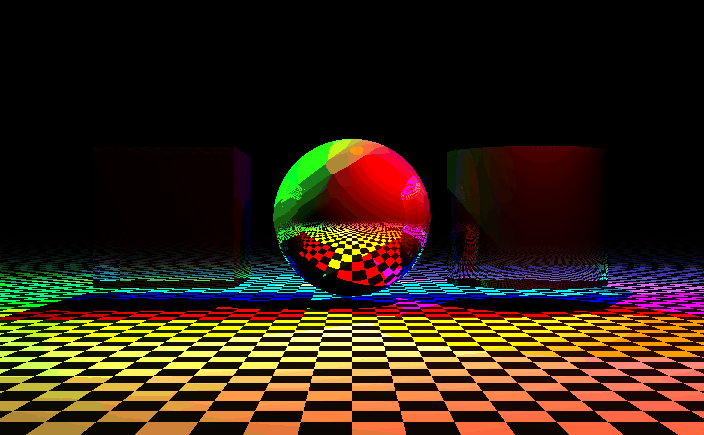

In [6]:
display_gif(encode_gif(s))